In [37]:
from src.utilities.fin_shape_utils import plot_mesh
from src.build.build06_fit_3D_mesh import fin_mesh_wrapper
import pandas as pd
import numpy as np
import glob2 as glob
import os
import trimesh
from tqdm import tqdm
import meshplot

In [38]:
# get list of refined fin mesh objects
root = "/media/nick/hdd02/Cole Trapnell's Lab Dropbox/Nick Lammers/Nick/pecfin_dynamics/"

fin_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", "*smoothed_fin_mesh*")))
raw_mesh_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", "*raw_fin_mesh*")))
fin_df_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", "*upsampled*")))
fin_df_c_list = sorted(glob.glob(os.path.join(root, "point_cloud_data", "processed_fin_data", "*data.csv")))

# print(fin_mesh_list[:10])
# print(fin_df_list[:10])

In [39]:
file_ind = 5

fin_mesh =trimesh.load(fin_mesh_list[file_ind])
raw_fin_mesh =trimesh.load(raw_mesh_list[file_ind])
fin_df = pd.read_csv(fin_df_list[file_ind])
fin_df_c = pd.read_csv(fin_df_c_list[file_ind])

fin_mesh_list[file_ind]

"/media/nick/hdd02/Cole Trapnell's Lab Dropbox/Nick Lammers/Nick/pecfin_dynamics/point_cloud_data/processed_fin_data/20240711_01_well0004_time0000_smoothed_fin_mesh.obj"

In [40]:
# wt_flags = []
# for i in tqdm(range(len(fin_mesh_list))):
#     temp_mesh = trimesh.load(fin_mesh_list[i])
#     wt_flags.append(temp_mesh.is_watertight)

In [41]:
# bad_indices = np.where(~np.asarray(wt_flags))[0]
# print(bad_indices)

In [42]:
import plotly.graph_objects as go 
verts, faces = fin_mesh.vertices, fin_mesh.faces
# meshplot.plot(verts, faces, shading={"wireframe": True})
fig, lines, mesh = plot_mesh(fin_mesh, surf_alpha=1)
# fig = go.Figure()
fig.add_trace(mesh)
fig.show()

In [43]:
import plotly.express as px

fin_df["nucleus_id_str"] = fin_df["nucleus_id"].astype(str)

fig = px.scatter_3d(fin_df, x="XB", y="YB", z="ZB", color="nucleus_id")
fig.update_traces(marker=dict(size=4))
fig.show()

In [25]:
from sklearn.cluster import DBSCAN

fin_data = fin_df_c[["XP", "YP", "ZP"]].to_numpy()

eps = 10
db = DBSCAN(eps=eps, min_samples=4).fit(fin_data)
labels = db.labels_
# lb, lbc = np.unique(labels, return_counts=True)
# lbc_top = lbc[0]
# lbc_frac = lbc / lbc_top
# outlier_labels = lb[lbc_frac < 0.1]
# outlier_flags = np.isin(labels, outlier_labels)

fig = px.scatter_3d(fin_df_c, x="XP", y="YP", z="ZP", color=labels)
fig.update_traces(marker=dict(size=5))
fig.show()

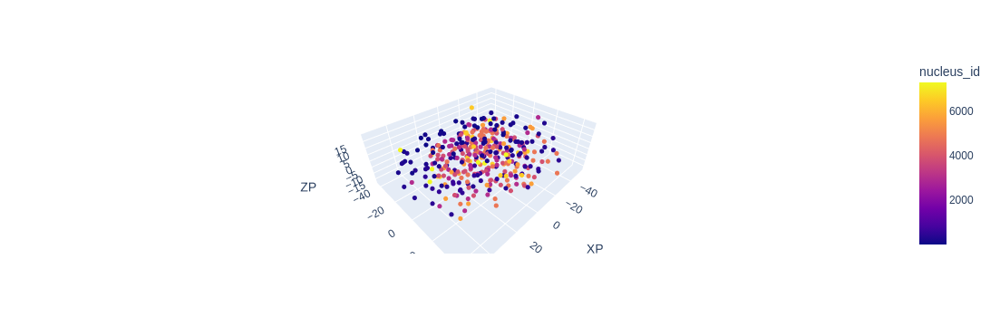

In [11]:
import plotly.express as px

fig = px.scatter_3d(fin_df_c, x="XP", y="YP", z="ZP", color="nucleus_id")
fig.update_traces(marker=dict(size=3))
fig.show()

In [6]:
import alphashape

n_points = fin_mesh.vertices.shape[0]
test = fin_df.loc[fin_df["nucleus_id"] != 6453, ["XB", "YB", "ZB"]].to_numpy() #esh.sample(10*n_points)

In [14]:
mm = np.min(test)
test_norm = test - mm
mx = np.max(test_norm)
test_norm = test_norm / mx

fin_mesh_new = alphashape.alphashape(test_norm, 19)

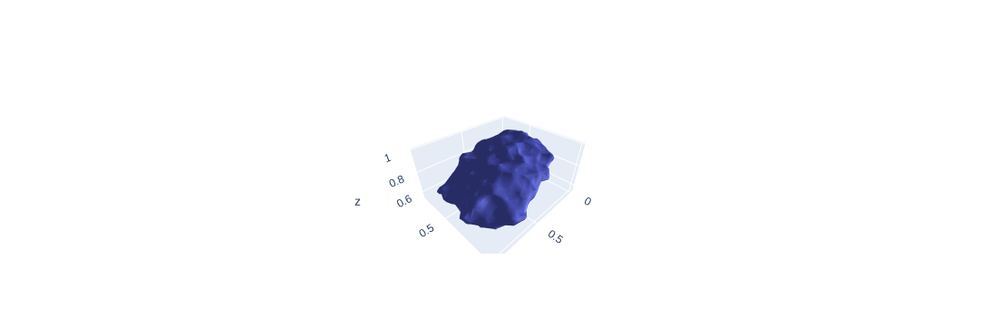

In [15]:
import plotly.graph_objects as go

print(fin_mesh_new.is_watertight)

_, lines, mesh = plot_mesh(fin_mesh_new, surf_alpha=1)
fig = go.Figure()
fig.add_trace(mesh)
fig.show()

### Test some tips from Casper